# Objective: Efficient Reading and Visualization of Large Files with Dask

This documentation explains how to efficiently read and visualize files with millions of rows using the Dask library instead of Pandas. It also covers prerequisites and provides insights into filtering and visualizing data with Basemap and Plotly.

1. **Introduction: Reading Large Files Efficiently with Dask**
- Objective: This documentation guides you in efficiently handling large datasets with millions of rows, particularly files from the years 2019-2020 (LITE files).
- `Using Dask Over Pandas:` When working with such large files, using Dask is recommended over Pandas due to its ability to handle computations in a distributed and parallelized manner (More information with visuals below). Pandas can be limited by memory constraints when dealing with extensive datasets. ask provides dask.dataframe for reading large datasets efficiently. It breaks data into smaller chunks, enabling parallel processing and efficient memory usage.
- Filtering Data: You can filter down the read files to focus on specific time periods, regions, or attributes. Dask's lazy evaluation allows you to create complex filtering operations without loading the entire dataset into memory.

2. **Prerequisite Libraries**
- Numpy, Dask, Pandas, Basemap, Plotly
- run the following command in the cell to install the libraries:
    - !pip install numpy dask pandas basemap plotly

3. **Data Source and Initial Setup**
- Source of Files: The files to be processed should already be downloaded to your local machine, potentially from a CLUSTER machine. Ensure you have these files ready for processing.

4. **Visualizing Data with Basemap and Plotly**
5. **Creating an Animation GIF**
- Objective: If you wish to create an animation GIF using Basemap and Plotly, this documentation can guide you through the process.

## Pre-requisites
- There are several required libraries to support this script
- EG: numpy, basemap, matplotlib, dask, plotly

In [1]:
# !pip install numpy dask pandas basemap plotly

In [1]:
from mpl_toolkits.basemap import Basemap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib

# for GIF creation
import PIL as plw 

# Animation and Graphics libraries
import plotly.express as px
import plotly
import seaborn as sns; sns.set()

In [2]:
from dask import dataframe as dd
from dask import delayed

# DASK: Distributed Threading

In [3]:
from  dask.distributed import Client

# Displaying the Memory Cluster

In [4]:
client= Client()
client

Connection method: Cluster object,Cluster type: LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Status: running,Using processes: True
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 4,Total memory: 15.88 GiB
Comm: tcp://127.0.0.1:61649,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 4
Started: Just now,Total memory: 15.88 GiB
Comm: tcp://127.0.0.1:61675,Total threads: 1
Dashboard: http://127.0.0.1:61676/status,Memory: 3.97 GiB
Nanny: tcp://127.0.0.1:61651,


# DASK to read Multiple FILES 

In [5]:
from IPython.display import Image

# EXAMPLE: HOW Dask Performs?
- How Parallel Processing Works on handling BIG Data

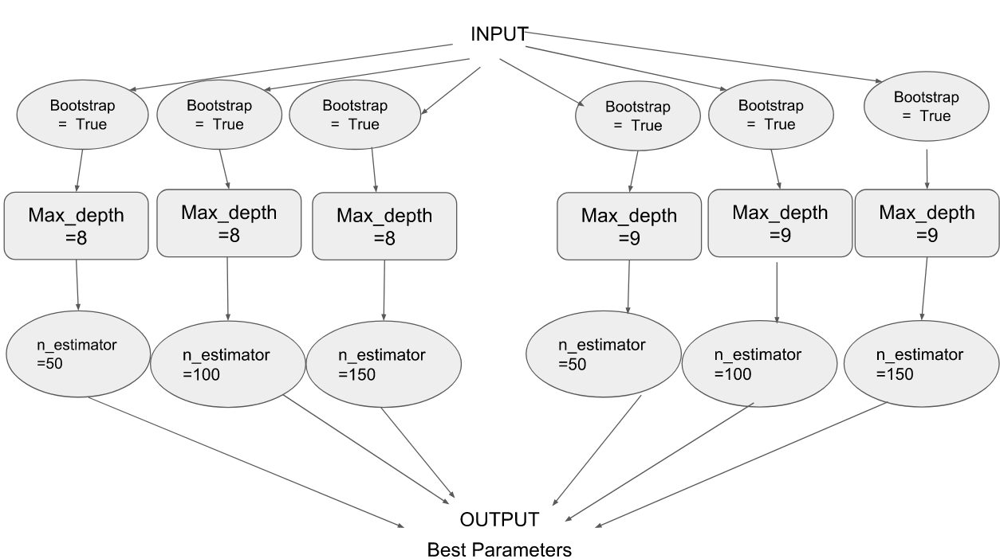

In [6]:
Image(filename='parallel_processing.png')

# Why use DASK ?
- Dask can enable efficient parallel computations on single machines by leveraging their multi-core CPUs and streaming data efficiently from disk. 
- It can run on a distributed cluster. 
- Dask also allows the user to replace clusters with a single-machine scheduler which would bring down the overhead

### Computing entire Datasets at once can take intensive Time

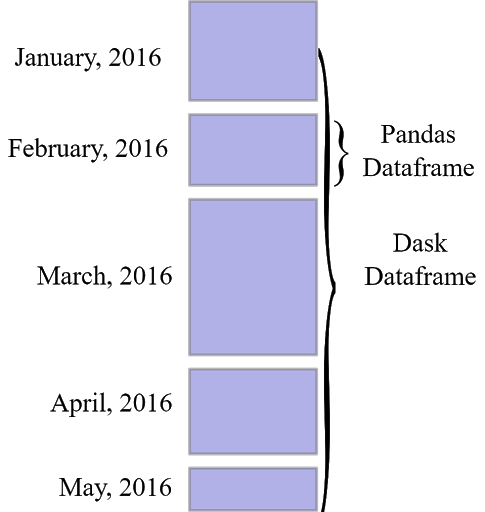

In [7]:
Image(filename= 'dask_Df.png')

# File location:
- For this tutorial, users are require to download the files from the server; EarthData, OpenDAP
- Further the original files which are on `netCDF` format are required to convert to `CSV`
- For example, Here the csv files are located on the path dir:`../../Clusters_DATA_oil/OCO-2/combined/*.csv`

In [8]:
entire_2019_2020= dd.read_csv("../../Clusters_DATA_oil/OCO-2/combined/*.csv")

# METADATA
- Shows the NUMBER of Paritions
- TOTAL Tasks

In [9]:
entire_2019_2020

,Xco2,Latitude,Longitude,quality_flag,DateTime,Year,Month,Day
npartitions=711,,,,,,,,
,float64,float64,float64,int64,object,int64,int64,int64
,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...


# OCO-2 Lite File:
- Lite files contain a subset of the information in
the IMAP-DOAS (IDP) pre-processing L2 files. There is one file per day, for each day that had at
least one retrieved sounding.

## Version: LtCO2_B10206Ar

# READING enitre FILES:
### Total Records:
- Here, we can see the total number of Rows after reading the combined files
- 171729500   
- Time Taken:
Wall time: 
    - 7min 51s
    

# Quality Flag
- The OCO-2 (Orbiting Carbon Observatory-2) quality flag attribute is a data attribute associated with measurements taken by the OCO-2 satellite instrument, which is designed to `monitor and measure carbon dioxide (CO2) concentrations` in the Earth's atmosphere. This quality flag is crucial for assessing the reliability and accuracy of the measured data points. Here's a brief explanation of the OCO-2 quality flag attribute:

### Purpose:

- `Data Quality Assessment:` It helps researchers and scientists assess the trustworthiness of the data. Data points with higher quality flags are considered more reliable and accurate for scientific analysis.

- `Error Detection:` The quality flag can indicate potential errors, anomalies, or issues with specific measurements, allowing for data quality control and troubleshooting.

- `Flag Values:` The quality flag typically consists of numeric or alphanumeric codes, each representing a specific quality or data condition. These values may vary depending on the specific dataset and data processing procedures. Common values may include:

    - Good Data: Values indicating that the measurement is considered reliable and accurate.
    - Marginal Data: Values indicating some uncertainty or potential issues with the measurement.
    - Bad Data: Values indicating that the measurement is likely to be inaccurate or unreliable.

- `Data Filtering:` Researchers often use the quality flag attribute to filter and select data points that meet certain quality criteria for their analysis. Filtering based on quality flags helps ensure that only high-quality data is included in scientific studies.
- `Temporal and Spatial Variability:` Quality flags can vary over time and across different regions, reflecting changing measurement conditions and instrument performance. Researchers need to consider these variations when analyzing OCO-2 data.

<b>best: Quality_Flag = 0</b>
satisfies all of the following conditions:
- 28 ≦ continuum radiance @757 nm ≦195 [W/m2/sr/μm]
- ≦ χ2@757 nm ≦ 2.0
- ≦ χ2@771 nm ≦ 2.0
- 0.85 ≦ O2 ratio ≦ 1.5
- 0.5 ≦ CO2 ratio ≦ 4.0
- ϴsun ≦ 70°
- Land Fraction = 100%

<b>good: Quality_Flag = 2</b>
does not satisfy best but satisfies all of the following:
- 28 ≦ continuum radiance @757 nm ≦ 195 [W/m2/sr/μm]
- ≦ χ2@757 nm ≦ 3.0
- ≦χ2@771 nm ≦ 3.0
- 0.85 ≦ O2 ratio ≦ 1.5
- 0.5 ≦ CO2 ratio ≦ 4.0
- ϴsun ≦ 70°
- Land Fraction ≧ 80%

<b>failed: Quality_Flag = 2</b>
anything neither best nor good.


## ELEMENTS:

Table 2-1: SIF Lite Quality Flag logic
Rationale for the quality screening elements:
- χ2 limits exclude fits that don’t represent the spectrum well.
- continuum level radiance limits exclude scenes of high and low brightness, which might
be more affected by detector calibration.
- solar zenith angle (ϴsun) limit removes retrievals with large airmasses, at which rotational
Raman scattering can be important.
- O2 and CO2 limits exclude most cloudy scenes.

In [10]:
#columns
entire_2019_2020.columns

Index(['Xco2', 'Latitude', 'Longitude', 'quality_flag', 'DateTime', 'Year',
       'Month', 'Day'],
      dtype='object')

# Segmenting the datasets by GOOD quality
## Gettng Good Quality Flag

In [11]:
%%time
df_good_quality_flag= entire_2019_2020[entire_2019_2020['quality_flag'] ==0].compute()

Wall time: 5min 36s


## Columns of dataframe

In [12]:
df_good_quality_flag.columns

Index(['Xco2', 'Latitude', 'Longitude', 'quality_flag', 'DateTime', 'Year',
       'Month', 'Day'],
      dtype='object')

## Further Segmentation:
- By Month and Year column creation

In [13]:
df_good_quality_flag['Date']= pd.to_datetime(df_good_quality_flag['DateTime'])

In [14]:
df_good_quality_flag['Year']= df_good_quality_flag['Date'].dt.year
df_good_quality_flag['Month']= df_good_quality_flag['Date'].dt.month
df_good_quality_flag['Day']= df_good_quality_flag['Date'].dt.day

In [15]:
df_good_quality_flag

,Xco2,Latitude,Longitude,quality_flag,DateTime,Year,Month,Day,Date
218,404.12680,-72.345080,-145.74565,0,2019-01-01 00:29:16.080,2019,1,1,2019-01-01 00:29:16.080
219,403.00842,-72.327960,-145.76468,0,2019-01-01 00:29:16.380,2019,1,1,2019-01-01 00:29:16.380
240,403.00748,-72.207100,-145.90018,0,2019-01-01 00:29:18.780,2019,1,1,2019-01-01 00:29:18.780
243,402.69230,-72.189890,-145.91942,0,2019-01-01 00:29:19.080,2019,1,1,2019-01-01 00:29:19.080
245,404.78226,-72.172680,-145.93861,0,2019-01-01 00:29:19.380,2019,1,1,2019-01-01 00:29:19.380
...,...,...,...,...,...,...,...,...,...
179331,417.14920,29.838942,-149.09099,0,2020-12-31 23:01:56.770,2020,12,31,2020-12-31 23:01:56.770
179332,416.54663,29.826334,-149.08119,0,2020-12-31 23:01:56.780,2020,12,31,2020-12-31 23:01:56.780
179333,418.60715,29.869259,-149.10674,0,2020-12-31 23:01:57.060,2020,12,31,2020-12-31 23:01:57.060
179334,416.86713,29.856771,-149.09683,0,2020-12-31 23:01:57.070,2020,12,31,2020-12-31 23:01:57.070


## Filter the data by different Year
- By Filtering the DASK Dataframe by YEAR COLUMN
- EXtract the datasets by different YEAR

In [16]:
%%time
df_2019= df_good_quality_flag[df_good_quality_flag['Year'] == 2019]
df_2020= df_good_quality_flag[df_good_quality_flag['Year'] == 2020]

Wall time: 1min 5s


## Retrieving 16 Day cycle for EACH month
- Missing datasets from year 2018, 2019

In [17]:
len(df_2019), len(df_2020)

(33270789, 31673386)

## PLOTLY Library to view the DATASET
### Example; Single Day

In [18]:
xco2_2019= df_2019[(df_2019['Month'] == 1)&(df_2019['Day']==1)]

In [19]:
fig_second= px.scatter_mapbox(xco2_2019,
                      lat= 'Latitude',
                      lon= 'Longitude',
                      color= 'Xco2',
                       zoom= 0,
                      hover_name='Date'
                      )

fig_second.update_layout(
mapbox_style="stamen-watercolor")

fig_second.show()

## NEXT STEP:

## BASEMAP to visualize the filtered data

## Considering the 16 day CYCLE period of OCO-2 on orbit
- We will take 16 day cycle period to visualize the data

In [20]:
first_half= np.arange(1, 17)
second_half= np.arange(17,32)

In [21]:
xco2_2019.Month.unique()

array([1], dtype=int64)

In [22]:
len(first_half),len(second_half)

(16, 15)

In [23]:
month= ['Jan', 'Feb','Mar', 'April','May','June','July','Aug','Sept','Aug','Nov','Dec']
month[11]

'Dec'

# BASEMAP: for each month

# 2019: Max and Min Values for XCO2

In [24]:
min(df_2019["Xco2"]),max(df_2019["Xco2"])

(383.46942, 428.56912)

In [25]:
np.linspace(min(df_2019["Xco2"]), max(df_2019["Xco2"]),6)

array([383.46942, 392.48936, 401.5093 , 410.52924, 419.54918, 428.56912])

# 2020: Max and Min Values for XCO2

In [26]:
range_xco2_17= np.arange(min(df_2020["Xco2"]), max(df_2020["Xco2"]), 10)
range_xco2_17

array([390.5612, 400.5612, 410.5612, 420.5612, 430.5612])

# BASEMAP
## NOTE:
- CHANGE PATH for every graphs
- CHange the COLOR bar RANGE for every year (MAX and MIIN)


In [27]:
# create a function that creates a BASEMAP
def map_by_month(data, year, month, vol, x="longiture",y= "latitude", lon_min= -180, lon_max= 180, lat_min= -90, lat_max= 90, size_point= 5, frontier= False):
    
    # Figure setting    
    plt.figure(figsize= (35, 20), edgecolor='b')
    
    #PROJECTION 'cyl' -> Equilateral Diagram
    m= Basemap(projection='cyl', resolution='c',
               llcrnrlat= lat_min, urcrnrlat=lat_max, llcrnrlon= lon_min, urcrnrlon= lon_max)


    m.scatter( data['Longitude'], data['Latitude'], c= data['Xco2'], cmap= plt.cm.turbo, s=30, #norm= normal,
             marker='d')
    
    # Customizing the COLORBAR
    cbar= plt.colorbar(orientation= "horizontal",
                      format= "%.0f",
                      extend="both",
                      shrink= 0.45,
                      aspect= 10,
                      pad= 0.04)
    
    cbar.set_label(label="XCO2 (parts per million)", size= 40)
    cbar.ax.tick_params(labelsize= 35)

    # ADJUSTT the CBAR by year
    cbar.set_ticks(np.linspace(390, 420, 5))
    plt.clim(390, 420)
    
    # BORDER Lining
    m.drawmapboundary(fill_color='black')
    
    # changing BACKGROUND color
    m.fillcontinents(color='grey', alpha= 0.25)
    plt.title('Orbiting Carbon Observatory- 2\nAtmospheric Carbon Dioxide Concentration\n'+str(year)+'-'+str(month), fontsize =50)
    
    # Saving the Graph into specified Directory
    
#     # Change the PATH for different years
#     plt.savefig("C:/Users/sagarl/JPL_Project/Code_Scripts/week_10/MONTHS_gif/2020/"+str(month)+"_"+str(vol)+".jpeg",
#                 dpi= 120)


# Testing a Single Day from the dataset

In [28]:
xco2_first= df_2019[(df_2019['Month'] ==1) & (df_2019['Day'] == 1)]

In [29]:
min(xco2_first["Xco2"]),max(xco2_first['Xco2'])

(393.00214, 419.36456)

Wall time: 734 ms


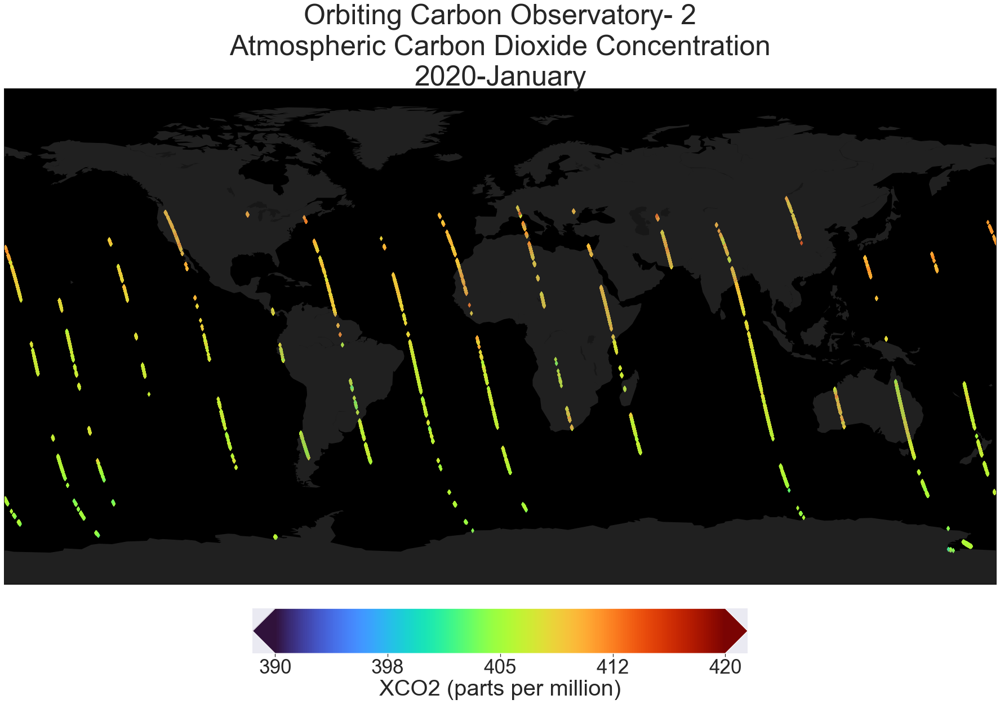

In [30]:
%%time
map_by_month(xco2_first, "2020", "January", "TEST")

# Describe the datasets for XCO2, 2019

In [31]:
df_2019["Xco2"].describe()

count    3.327079e+07
mean     4.093015e+02
std      1.914314e+00
min      3.834694e+02
25%      4.080925e+02
50%      4.092936e+02
75%      4.103928e+02
max      4.285691e+02
Name: Xco2, dtype: float64

In [32]:
len(df_2019["Xco2"][df_2019["Xco2"]> 419 ])

132

# Scatter Plots to determine outliers on XCO2

## 2019

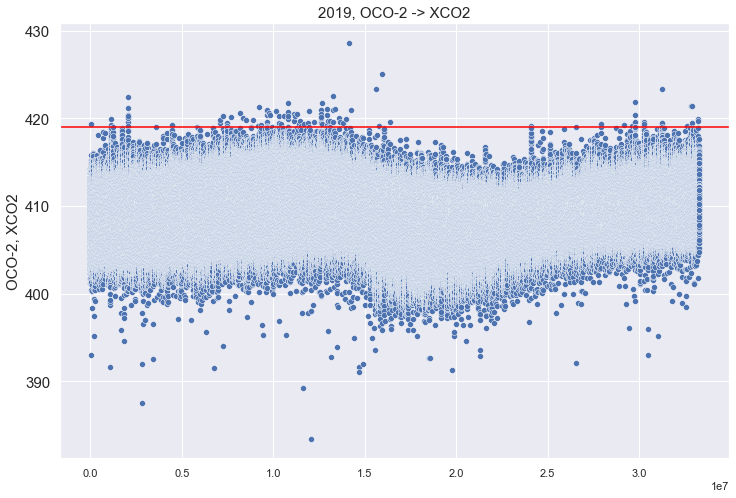

In [33]:
# %%time
# sns.scatterplot(np.arange(0, len( df_2019["Xco2"])), df_2019["Xco2"])
# plt.gcf().set_size_inches(12,8)
# plt.axhline(y= 419, color='red', linestyle='-')
# plt.ylabel('OCO-2, XCO2', fontsize= 15)
# plt.title('2019, OCO-2 -> XCO2', fontsize= 15)
# plt.yticks(fontsize= 15);

Image(filename= "../week_10/scatter_plots_/oco2/2019_OCO-2.png")

## 2020

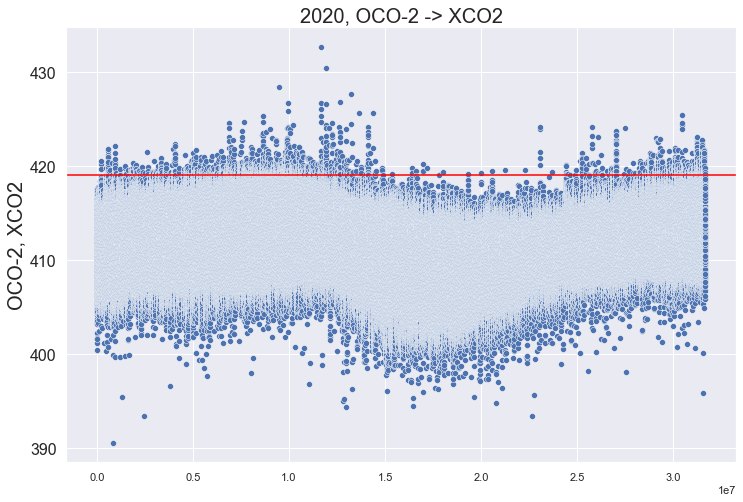

In [34]:
# %%time
# sns.scatterplot(np.arange(0, len( df_2020["Xco2"])), df_2020["Xco2"])
# plt.gcf().set_size_inches(12,8)
# plt.axhline(y= 419, color='red', linestyle='-')
# plt.ylabel('OCO-2, XCO2', fontsize= 20)
# plt.title('2020, OCO-2 -> XCO2', fontsize= 20)
# plt.yticks(fontsize= 16);
Image(filename='../week_10/scatter_plots_/oco2/2020_OCO-2.png')

# Check the dataset: 2019

In [44]:
df_2019["Month"].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int64)

In [36]:
test= df_2019[df_2019["Month"] == 1]
test

,Xco2,Latitude,Longitude,quality_flag,DateTime,Year,Month,Day,Date
218,404.12680,-72.345080,-145.74565,0,2019-01-01 00:29:16.080,2019,1,1,2019-01-01 00:29:16.080
219,403.00842,-72.327960,-145.76468,0,2019-01-01 00:29:16.380,2019,1,1,2019-01-01 00:29:16.380
240,403.00748,-72.207100,-145.90018,0,2019-01-01 00:29:18.780,2019,1,1,2019-01-01 00:29:18.780
243,402.69230,-72.189890,-145.91942,0,2019-01-01 00:29:19.080,2019,1,1,2019-01-01 00:29:19.080
245,404.78226,-72.172680,-145.93861,0,2019-01-01 00:29:19.380,2019,1,1,2019-01-01 00:29:19.380
...,...,...,...,...,...,...,...,...,...
167312,407.50860,-26.807981,-153.64049,0,2019-01-31 23:59:50.320,2019,1,31,2019-01-31 23:59:50.320
167317,407.16290,-26.808226,-153.67735,0,2019-01-31 23:59:50.750,2019,1,31,2019-01-31 23:59:50.750
167319,407.11340,-26.777086,-153.69700,0,2019-01-31 23:59:51.360,2019,1,31,2019-01-31 23:59:51.360
167320,407.34152,-26.789232,-153.71909,0,2019-01-31 23:59:51.380,2019,1,31,2019-01-31 23:59:51.380


# Basemap for Month: JAN

Wall time: 556 ms


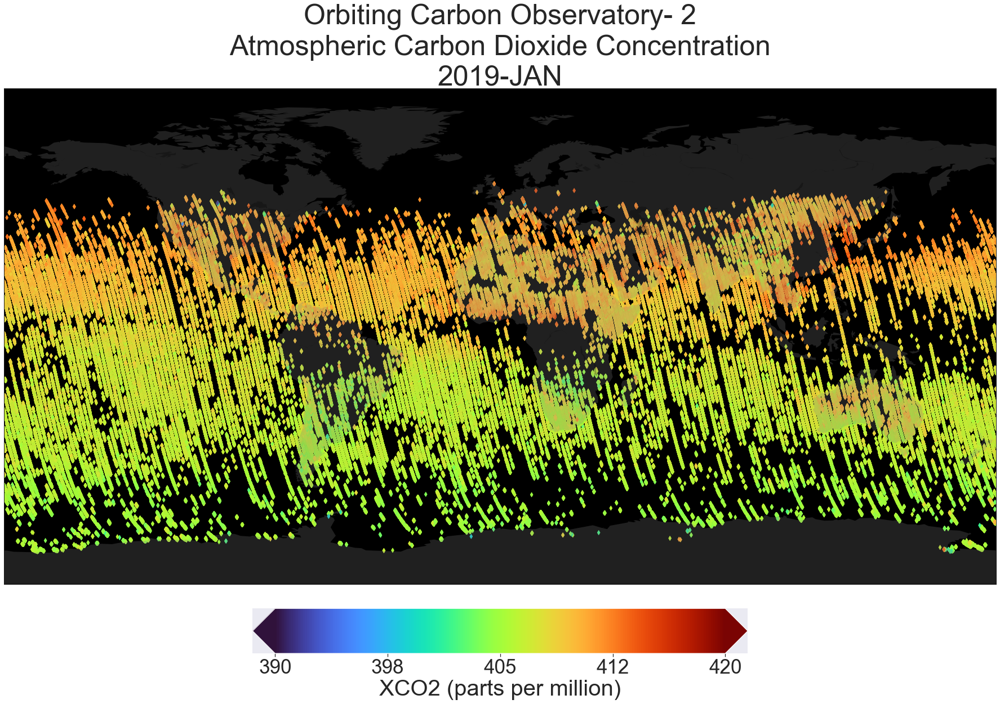

In [37]:
%%time
map_by_month(test, "2019","JAN","_TEST_")

# FIRST HALF (16 DAY PERIOD): 2019

## Approach:
### Create THREE Frames per months:

1. First Frame, Retrieve the Datasets for 16 day cycle period
2. Second Frame, Retrieve the Datasets for next 15 day cycle period totalling to 31 DAY cycle
3. Third Frame, TOTAL datasets for Each month

# FINAL step: 
- Creating a GIF format FILE that combines all the THREE frames 
- Creates an animation 

# a. First Frame, selecting the RIGHT dataset
- Uncomment the datasets and SELECT the Right dataset from previous work
- 2019 and 2020

In [38]:
# # # Selection of different Months
# rep= 0

# for j in range(1, 13):

#     # First HALF of the month
#     first_half= np.arange(1, 17)
#     second_half= np.arange(17,32)

#     # months
 
#     month= ['January', 'February','March', 'April','May','June','July','August','September','October','November','December']

#     # Get data for every month by 16 day cycle period:
    
#     vol_1= df_2020[(df_2020['Month']== j)&(df_2020['Day'].isin(first_half))]

## Using the BASEMAP function for different DATASET
#     map_by_month(vol_1, "2020",month[rep], "_first")


#     rep+=1

# b. Second Frame (15 Day period of the month): df_2020

In [39]:
# # # diff months
# rep= 0

# for j in range(1, 13):

#     # TWO sections: Selecting the remaining 15 day period
#     second_half= np.arange(17,32)

#     # months
#     month= ['January', 'February','March', 'April','May','June','July','August','September','October','November','December']

#     # Get data for REMAINING 15 DAYS:
#     vol_2= df_2020[(df_2020['Month']== j)&(df_2020['Day'].isin(second_half))]
#     map_by_month(vol_2, "2020", month[rep],"_second")

#     rep+=1

# c. Third FRAME: Taking TOTAL Datasets for Each month

In [40]:
# rep= 0
# for j in range(1, 13):

#     # Entire DATASET Selection
#     # months
#     month= ['January', 'February','March', 'April','May','June','July','August','September','October','November','December']

# # BY monthly: Entire datasets
    

#     vol_2= df_2020[df_2020['Month']== j]
#     map_by_month(vol_2, "2020", month[rep],"_total")

#     rep+=1

# Creating a GIF file format
## Approach:
- Combine the files by specific Month period numerically
- EG: 1. january_first, 2. januar_second, 3 january_total, 4. feb_first, 5. feb_second, 6. feb_total
- 

# Create GIF

# 2019 and 2020

In [41]:
# image_frames=[]

# days= np.arange(1,37)

# # looping over the IMGAES 
# for j in days:
#     day_one= plw.Image.open('C:/Users/sagarl/JPL_Project/Code_Scripts/week_10/MONTHS_gif/2020/'+str(j)+'.jpeg')
#     image_frames.append(day_one)
    

# # Creating a GIF
# image_frames[0].save('MONTHS_gif/2020_year.gif', format= 'GIF',
#                     append_images= image_frames[1:],
#                     save_all= True, duration= 800,
#                     fps=10,
#                     loop= 0)

# COMBINE two years GIF

# 2019 and 2020

In [42]:
# image_frames=[]

# days= np.arange(1,3)

# # looping over the IMGAES 
# for j in days:
#     day_one= plw.Image.open('C:/Users/sagarl/JPL_Project/Code_Scripts/week_10/MONTHS_gif/'+str(j)+'.gif')
#     image_frames.append(day_one)
    

# # Creating a GIF
# image_frames[0].save('MONTHS_gif/xco2_variations_2019_2020.gif', format= 'GIF',
#                     append_images= image_frames[1:],
#                     save_all= True, duration= 620,
#                     fps=10,
#                     loop= 0)

In [43]:
days= np.arange(1,3)
days

array([1, 2])